In [1]:
import scanpy as sc
import scvi 
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import torch

/Applications/anaconda3/envs/scvi/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# Integration using scvi

## Load all the datasets and concatante into one object

In [2]:
from tqdm import tqdm

dir_name = ['D8_1','D8_2','D12_1','D12_2','D20_1', 'D20_2', 'D22_1', 'D22_2']

adatasets = []
for name in tqdm(dir_name):

    exec(f"adata_tmp = sc.read_10x_mtx('../../data/initial_10x_outputs/filtered_features/filtered_feature_bc_matrix-' + name)")
    #sc.pl.highest_expr_genes(adata_tmp, n_top=20)

    #Basic filtering genes not expressed + cell with too few genes
    sc.pp.filter_cells(adata_tmp, min_genes=200)
    sc.pp.filter_genes(adata_tmp, min_cells=3)

    #Define the mitochondrial genes + compute QC metrics
    adata_tmp.var["mt"] = adata_tmp.var_names.str.startswith("MT-")
    sc.pp.calculate_qc_metrics(
        adata_tmp, qc_vars=["mt"], percent_top=None, log1p=False, inplace=True
    )
    
    #Visualization QC metrics
    """ plt.hist(adata_tmp.obs.n_genes, bins=50)
    plt.title("Number of genes per cell")
    plt.show()

    plt.hist(adata_tmp.obs.pct_counts_mt, bins=50)
    plt.title("Percentage of mitochodrial genes per cells")
    plt.show() """

    #sc.pl.scatter(adata_tmp, x="total_counts", y="n_genes_by_counts")

    #Filter cells 
    #Remove all cell with % mt > 20% + extreme total counts
    adata_tmp = adata_tmp[adata_tmp.obs.pct_counts_mt < 20]
    adata_tmp = adata_tmp[adata_tmp.obs.total_counts < 100000]
    adata_tmp = adata_tmp[np.logical_and(adata_tmp.obs.n_genes > 900,adata_tmp.obs.n_genes < 6000)]

    # Saving count data
    """ adata_tmp.layers["counts"] = adata_tmp.X.copy()
    # Normalizing to median total counts
    sc.pp.normalize_total(adata_tmp)
    # Logarithmize the data
    sc.pp.log1p(adata_tmp) """
        
    adatasets.append(adata_tmp)        
    

adata = adatasets[0]


  0%|          | 0/8 [00:00<?, ?it/s]

100%|██████████| 8/8 [10:02<00:00, 75.36s/it]


In [3]:
adata = adata.concatenate(adatasets[1:], join="outer")

#Feature selection 
sc.pp.highly_variable_genes(adata, 
                            n_top_genes=5000,
                            flavor='seurat_v3',
                            batch_key='batch'
)

adata = adata[:, adata.var.highly_variable].copy()

adata

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_90105/3845947206.py:1: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  adata = adata.concatenate(adatasets[1:], join="outer")


AnnData object with n_obs × n_vars = 100742 × 5000
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch'
    var: 'gene_ids-0', 'feature_types-0', 'n_cells-0', 'mt-0', 'n_cells_by_counts-0', 'mean_counts-0', 'pct_dropout_by_counts-0', 'total_counts-0', 'gene_ids-1', 'feature_types-1', 'n_cells-1', 'mt-1', 'n_cells_by_counts-1', 'mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts-1', 'gene_ids-2', 'feature_types-2', 'n_cells-2', 'mt-2', 'n_cells_by_counts-2', 'mean_counts-2', 'pct_dropout_by_counts-2', 'total_counts-2', 'gene_ids-3', 'feature_types-3', 'n_cells-3', 'mt-3', 'n_cells_by_counts-3', 'mean_counts-3', 'pct_dropout_by_counts-3', 'total_counts-3', 'gene_ids-4', 'feature_types-4', 'n_cells-4', 'mt-4', 'n_cells_by_counts-4', 'mean_counts-4', 'pct_dropout_by_counts-4', 'total_counts-4', 'gene_ids-5', 'feature_types-5', 'n_cells-5', 'mt-5', 'n_cells_by_counts-5', 'mean_counts-5', 'pct_dropout_by_counts-5', 'total_counts-5', 'gene

In [59]:
117724 - 100742

16982

In [ ]:
adata.obs.batch

AAACAGCCAAACGCGA-1-0-0    0
AAACAGCCACAGGAAT-1-0-0    0
AAACAGCCACATGCTA-1-0-0    0
AAACAGCCAGGCCATT-1-0-0    0
AAACAGCCATCCGTAA-1-0-0    0
                         ..
TTTGTGTTCCCGTTGT-1-7      7
TTTGTGTTCGTAATCA-1-7      7
TTTGTTGGTCCGCTGT-1-7      7
TTTGTTGGTGTGAGAG-1-7      7
TTTGTTGGTTTGGTTC-1-7      7
Name: batch, Length: 189679, dtype: category
Categories (8, object): ['0', '1', '2', '3', '4', '5', '6', '7']

In [33]:
# change batch keys to be replicate id
batch_keys_dict = {"0":"D8-1", "1":"D8-2", "2":"D12-1", "3":"D12-2", "4":"D20-1", "5":"D20-2", "6":"D22-1", "7":"D22-2"}


adata.obs['batch'] = adata.obs.batch.cat.rename_categories(batch_keys_dict)

adata.obs.batch

AAACAGCCAAACGCGA-1-0     D8-1
AAACAGCCACAGGAAT-1-0     D8-1
AAACAGCCACATGCTA-1-0     D8-1
AAACAGCCAGGCCATT-1-0     D8-1
AAACAGCCATCCGTAA-1-0     D8-1
                        ...  
TTTGTGTTCCCGTTGT-1-7    D22-2
TTTGTGTTCGTAATCA-1-7    D22-2
TTTGTTGGTCCGCTGT-1-7    D22-2
TTTGTTGGTGTGAGAG-1-7    D22-2
TTTGTTGGTTTGGTTC-1-7    D22-2
Name: batch, Length: 100742, dtype: category
Categories (8, object): ['D8-1', 'D8-2', 'D12-1', 'D12-2', 'D20-1', 'D20-2', 'D22-1', 'D22-2']

In [ ]:
# change batch keys to be time id
batch_keys_dict = {"0":"D8", "2":"D12", "4":"D20", "6":"D22"}

adata.obs.batch[adata.obs.batch == '1'] = '0'
adata.obs.batch[adata.obs.batch == '3'] = '2'
adata.obs.batch[adata.obs.batch == '5'] = '4'
adata.obs.batch[adata.obs.batch == '7'] = '6'


adata.obs['batch'] = adata.obs.batch.cat.rename_categories(batch_keys_dict)

adata.obs.batch

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_25046/84572283.py:4: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata.obs.batch[adata.obs.batch == '1'] = '0'
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_25046/8457

AAACAGCCAAACGCGA-1-0     D8
AAACAGCCACAGGAAT-1-0     D8
AAACAGCCACATGCTA-1-0     D8
AAACAGCCAGGCCATT-1-0     D8
AAACAGCCATCCGTAA-1-0     D8
                       ... 
TTTGTGTTCCCGTTGT-1-7    D22
TTTGTGTTCGTAATCA-1-7    D22
TTTGTTGGTCCGCTGT-1-7    D22
TTTGTTGGTGTGAGAG-1-7    D22
TTTGTTGGTTTGGTTC-1-7    D22
Name: batch, Length: 100742, dtype: category
Categories (8, object): ['D8', '1', 'D12', '3', 'D20', '5', 'D22', '7']

In [34]:
adata.obs.batch = adata.obs.batch.cat.remove_unused_categories()
adata.obs.batch

AAACAGCCAAACGCGA-1-0     D8-1
AAACAGCCACAGGAAT-1-0     D8-1
AAACAGCCACATGCTA-1-0     D8-1
AAACAGCCAGGCCATT-1-0     D8-1
AAACAGCCATCCGTAA-1-0     D8-1
                        ...  
TTTGTGTTCCCGTTGT-1-7    D22-2
TTTGTGTTCGTAATCA-1-7    D22-2
TTTGTTGGTCCGCTGT-1-7    D22-2
TTTGTTGGTGTGAGAG-1-7    D22-2
TTTGTTGGTTTGGTTC-1-7    D22-2
Name: batch, Length: 100742, dtype: category
Categories (8, object): ['D8-1', 'D8-2', 'D12-1', 'D12-2', 'D20-1', 'D20-2', 'D22-1', 'D22-2']

# Cluster without integration

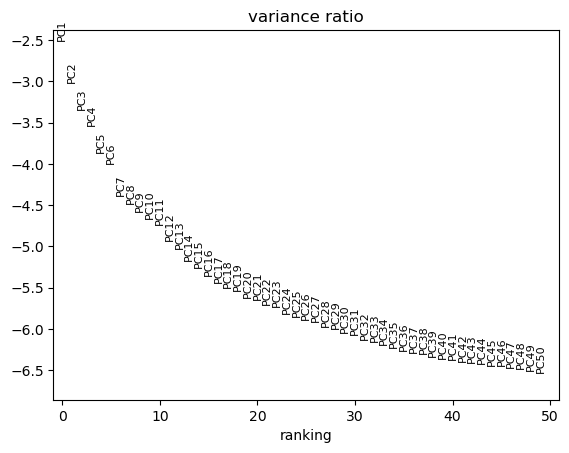

In [35]:
sc.tl.pca(adata)
sc.pl.pca_variance_ratio(adata, n_pcs=50, log=True)

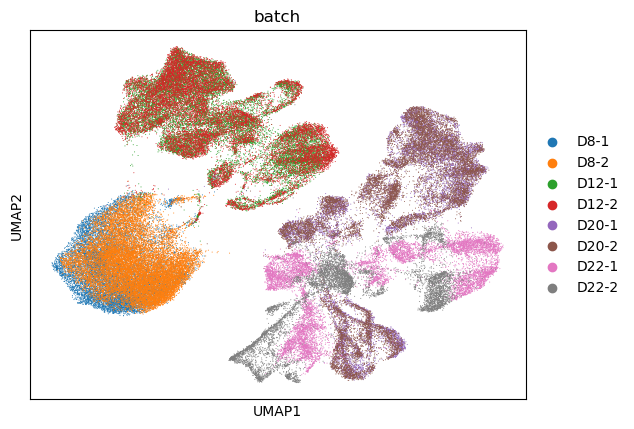

In [36]:
sc.pp.neighbors(adata)
sc.tl.umap(adata)

sc.pl.umap(
    adata,
    color="batch",
    # Setting a smaller point size to get prevent overlap
    size=2,
)

## Set up of model for scvi

In [4]:
# Set up the model for scvi
adata.layers["counts"] = adata.X.copy()  
scvi.model.SCVI.setup_anndata(
    adata,
    layer="counts",
    batch_key='batch'
)

sc.pp.highly_variable_genes(adata, 
                            n_top_genes=5000,
                            flavor='seurat_v3',
                            batch_key='batch'
)


In [5]:
model = scvi.model.SCVI(adata)
model

SCVI model with the following parameters: 
n_hidden: 128, n_latent: 10, n_layers: 1, dropout_rate: 0.1, dispersion: gene, gene_likelihood: zinb, 
latent_distribution: normal.
Training status: Not Trained
Model's adata is minified?: False

In [8]:
model.train()

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/Applications/anaconda3/envs/LeKIra/lib/python3.11/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=3` in the `DataLoader` to improve performance.


Epoch 1/79:   0%|          | 0/79 [00:00<?, ?it/s]

/Applications/anaconda3/envs/LeKIra/lib/python3.11/site-packages/lightning/pytorch/trainer/call.py:54: Detected KeyboardInterrupt, attempting graceful shutdown...


In [ ]:
model_dir =  "../data/models/scvi_model"
model.save(model_dir, overwrite=True)

## Use latent representation from model to cluster datasets

In [6]:
model_dir =  "../../models/scvi_model"
model = scvi.model.SCVI.load(model_dir, adata=adata)

INFO     File ../../models/scvi_model/model.pt already downloaded                                                  


In [7]:
model

SCVI model with the following parameters: 
n_hidden: 128, n_latent: 10, n_layers: 1, dropout_rate: 0.1, dispersion: gene, gene_likelihood: zinb, 
latent_distribution: normal.
Training status: Trained
Model's adata is minified?: False

In [8]:
SCVI_LATENT_KEY = "X_scVI"

latent = model.get_latent_representation()
adata.obsm[SCVI_LATENT_KEY] = latent
latent.shape

(100742, 10)

In [9]:
# use scVI latent space for UMAP generation
sc.pp.neighbors(adata, use_rep=SCVI_LATENT_KEY)


In [10]:
sc.tl.umap(adata, min_dist=0.3)

In [ ]:
# change batch keys to be replicate id
batch_keys_dict = {"0":"D8-1", "1":"D8-2", "2":"D12-1", "3":"D12-2", "4":"D20-1", "5":"D20-2", "6":"D22-1", "7":"D22-2"}

adata.obs['batch'] = adata.obs.batch.cat.rename_categories(batch_keys_dict)


In [ ]:
adata.obs.batch = adata.obs.batch.cat.remove_unused_categories()
adata.obs.batch

AAACAGCCAAACGCGA-1-0     D8-1
AAACAGCCACAGGAAT-1-0     D8-1
AAACAGCCACATGCTA-1-0     D8-1
AAACAGCCAGGCCATT-1-0     D8-1
AAACAGCCATCCGTAA-1-0     D8-1
                        ...  
TTTGTGTTCCCGTTGT-1-7    D22-2
TTTGTGTTCGTAATCA-1-7    D22-2
TTTGTTGGTCCGCTGT-1-7    D22-2
TTTGTTGGTGTGAGAG-1-7    D22-2
TTTGTTGGTTTGGTTC-1-7    D22-2
Name: batch, Length: 100742, dtype: category
Categories (8, object): ['D8-1', 'D8-2', 'D12-1', 'D12-2', 'D20-1', 'D20-2', 'D22-1', 'D22-2']

In [23]:
# change batch keys 
batch_keys_dict = {"0":"D8", "2":"D12", "4":"D20", "6":"D22"}

adata.obs.batch[adata.obs.batch == '1'] = '0'
adata.obs.batch[adata.obs.batch == '3'] = '2'
adata.obs.batch[adata.obs.batch == '5'] = '4'
adata.obs.batch[adata.obs.batch == '7'] = '6'


adata.obs['batch'] = adata.obs.batch.cat.rename_categories(batch_keys_dict)
adata.obs.batch = adata.obs.batch.cat.remove_unused_categories()



/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_76975/340877049.py:4: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata.obs.batch[adata.obs.batch == '1'] = '0'
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_76975/340

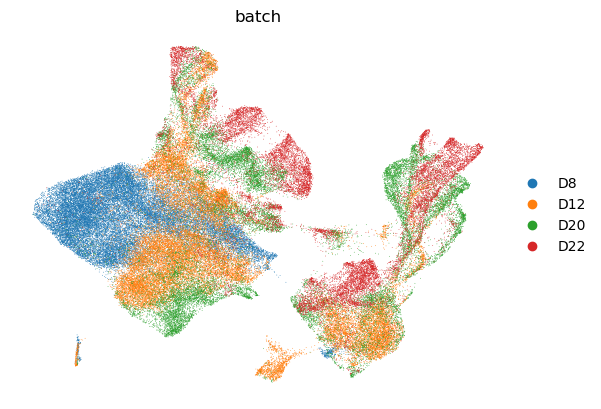

In [24]:
sc.pl.umap(
    adata,
    color=["batch"],
    frameon=False
)

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_90105/1504970241.py:3: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata, key_added=SCVI_CLUSTERS_KEY, resolution=0.5)


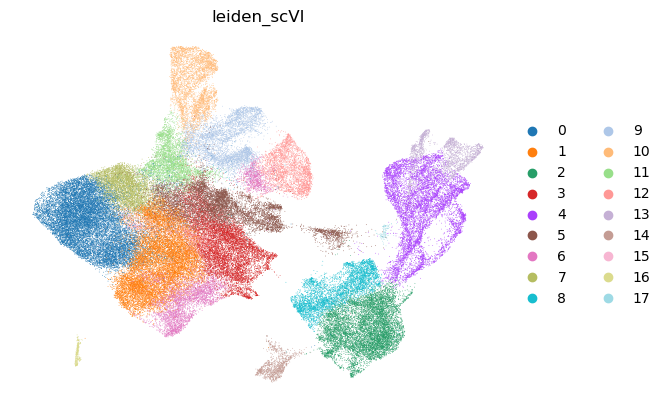

In [11]:
#Cluster on latent space
SCVI_CLUSTERS_KEY = "leiden_scVI"
sc.tl.leiden(adata, key_added=SCVI_CLUSTERS_KEY, resolution=0.5)

sc.pl.umap(
    adata,
    color=[SCVI_CLUSTERS_KEY],
    frameon=False,
)

/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


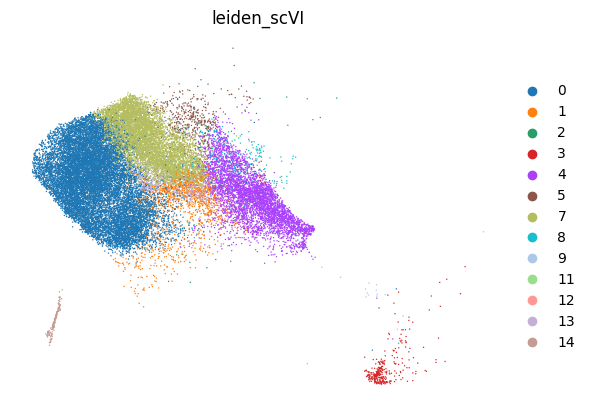

/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


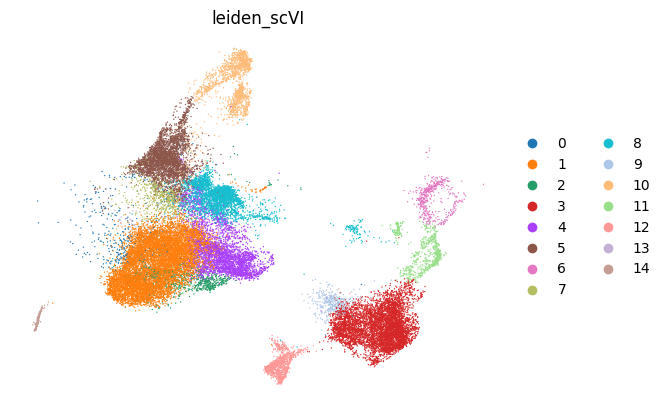

/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


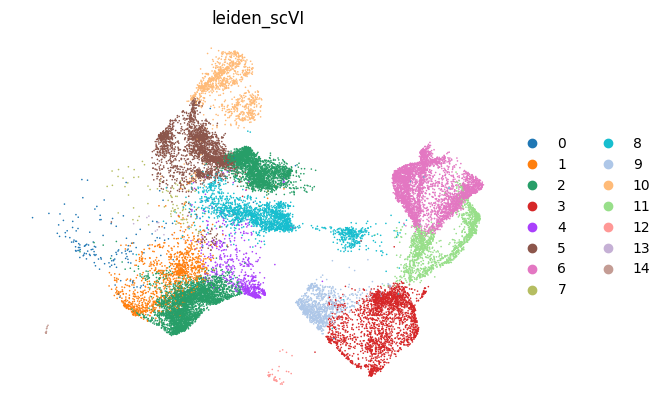

/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


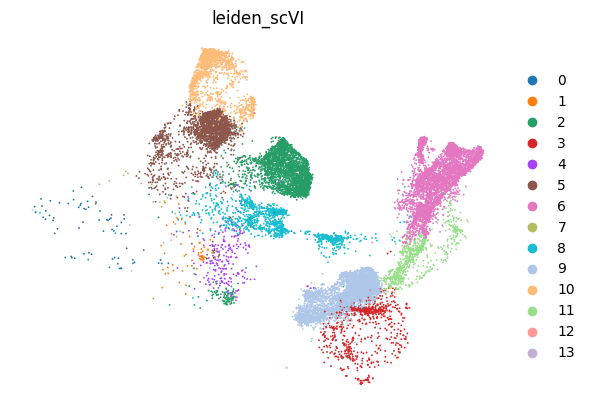

In [ ]:
sc.pl.umap(
    adata[np.logical_or(adata.obs.batch == '0', adata.obs.batch == '1')],
    color=[SCVI_CLUSTERS_KEY],
    frameon=False,
)
sc.pl.umap(
    adata[np.logical_or(adata.obs.batch == '2', adata.obs.batch == '3')],
    color=[SCVI_CLUSTERS_KEY],
    frameon=False,
)
sc.pl.umap(
    adata[np.logical_or(adata.obs.batch == '4', adata.obs.batch == '5')],
    color=[SCVI_CLUSTERS_KEY],
    frameon=False,
)
sc.pl.umap(
    adata[np.logical_or(adata.obs.batch == '6', adata.obs.batch == '7')],
    color=[SCVI_CLUSTERS_KEY],
    frameon=False,
)

In [12]:
# Normalize + log transform
sc.pp.normalize_per_cell(adata)
sc.pp.log1p(adata)

In [13]:
sc.tl.rank_genes_groups(adata, groupby=SCVI_CLUSTERS_KEY, method="wilcoxon")

sc.pl.rank_genes_groups_dotplot(
    adata, groupby=SCVI_CLUSTERS_KEY, standard_scale="var", n_genes=20
)

KeyboardInterrupt: 

In [49]:
adata

AnnData object with n_obs × n_vars = 100742 × 5000
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', '_scvi_batch', '_scvi_labels', 'leiden_scVI', 'n_counts'
    var: 'gene_ids-0', 'feature_types-0', 'n_cells-0', 'mt-0', 'n_cells_by_counts-0', 'mean_counts-0', 'pct_dropout_by_counts-0', 'total_counts-0', 'gene_ids-1', 'feature_types-1', 'n_cells-1', 'mt-1', 'n_cells_by_counts-1', 'mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts-1', 'gene_ids-2', 'feature_types-2', 'n_cells-2', 'mt-2', 'n_cells_by_counts-2', 'mean_counts-2', 'pct_dropout_by_counts-2', 'total_counts-2', 'gene_ids-3', 'feature_types-3', 'n_cells-3', 'mt-3', 'n_cells_by_counts-3', 'mean_counts-3', 'pct_dropout_by_counts-3', 'total_counts-3', 'gene_ids-4', 'feature_types-4', 'n_cells-4', 'mt-4', 'n_cells_by_counts-4', 'mean_counts-4', 'pct_dropout_by_counts-4', 'total_counts-4', 'gene_ids-5', 'feature_types-5', 'n_cells-5', 'mt-5', 'n_cells_by_counts-5', 'mean_cou

In [14]:
for i in np.unique(adata.obs.leiden_scVI):
    dedf = sc.get.rank_genes_groups_df(adata, group=i)
    dedf.names.to_csv(('gene_list/' + i + '.csv'), index=False)


AttributeError: 'DataFrame' object has no attribute 'leiden_scVI'

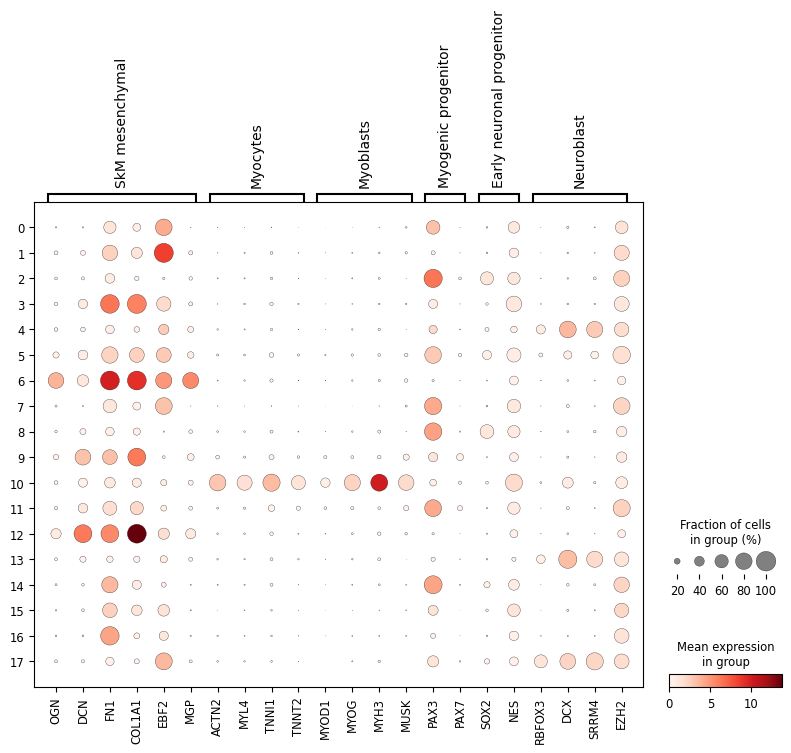

In [31]:
marker_genes = {
    "SkM mesenchymal": ["OGN",'DCN','FN1','COL1A1','EBF2','MGP'],
    "Myocytes": ["ACTN2", "MYL4", "TNNI1",'TNNT2'],
    "Myoblasts": ['MYOD1','MYOG','MYH3', 'MUSK'],
    "Myogenic progenitor": ['PAX3','PAX7'],
    "Early neuronal progenitor": ['SOX2','NES'],
    'Neuroblast': ['RBFOX3','DCX','SRRM4','EZH2']
}
sc.pl.dotplot(adata, marker_genes, groupby=SCVI_CLUSTERS_KEY)

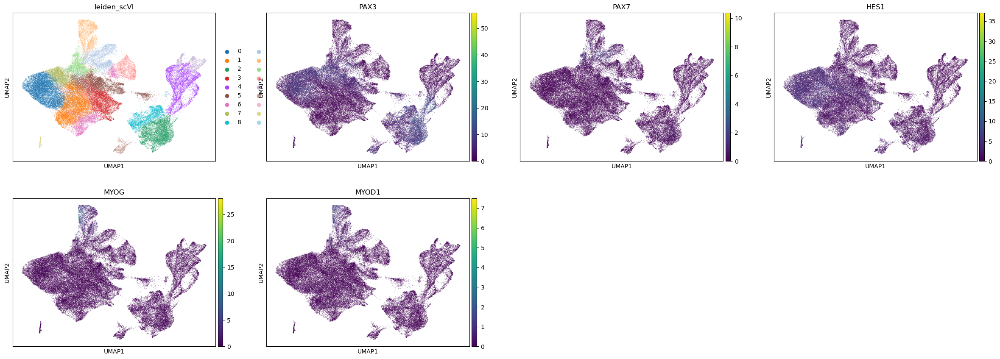

In [30]:
sc.pl.umap(adata, color=[SCVI_CLUSTERS_KEY, "PAX3",'PAX7','HES1','MYOG','MYOD1'])

In [58]:
adata.var_names.to_series().to_csv('test.csv', index=False)

In [ ]:
# Normalizing to median total counts
sc.pp.normalize_total(adata)

/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


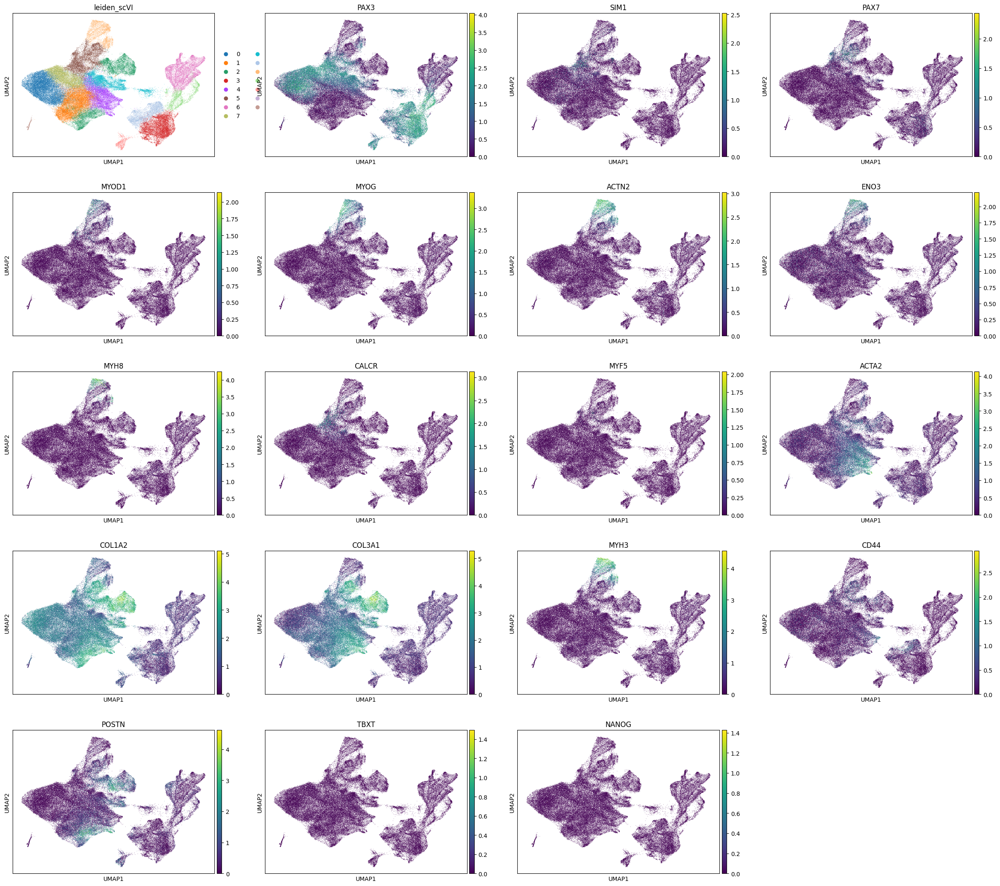

In [100]:
sc.pl.umap(adata, color=[SCVI_CLUSTERS_KEY, "PAX3", 'SIM1', 'PAX7', 'MYOD1','MYOG', 
                         'ACTN2', 'ENO3', 'MYH8', 'CALCR','MYF5','ACTA2','COL1A2',
                         'COL3A1','MYH3','CD44','POSTN','TBXT', 'NANOG','POU5F1'])


/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


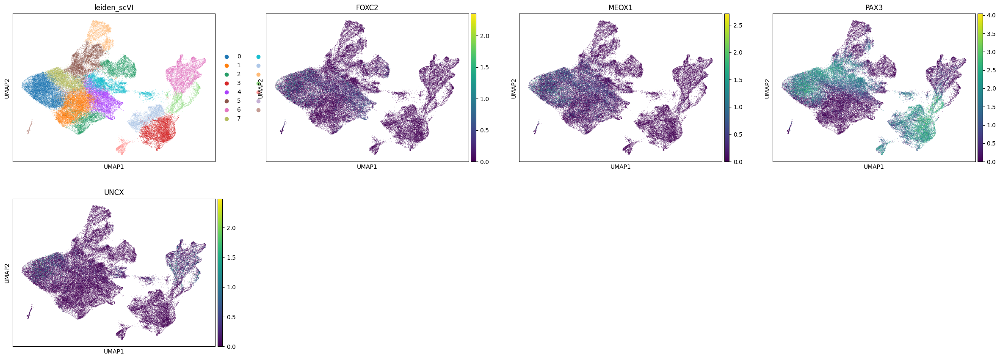

In [107]:
#Somite markers
sc.pl.umap(adata, color=[SCVI_CLUSTERS_KEY, "FOXC2",'MEOX1','PAX3','UNCX'])

/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


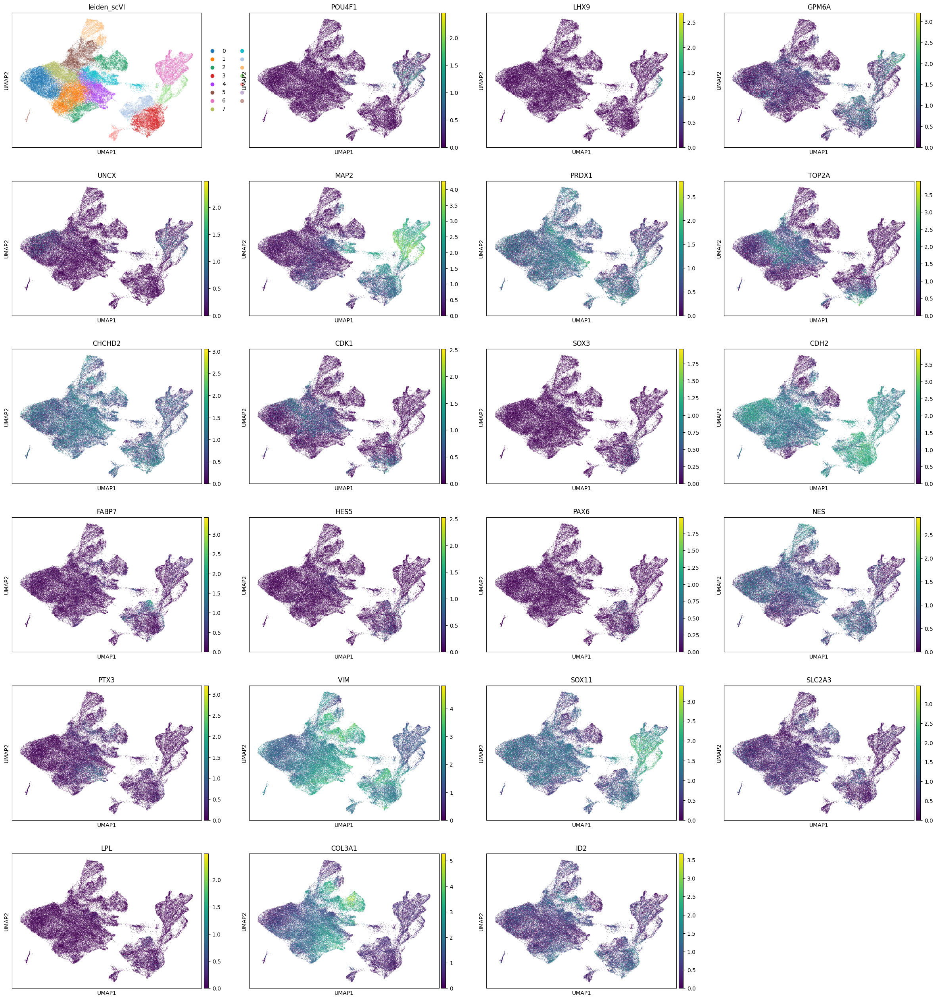

In [122]:
#Exploration neuronal markers
sc.pl.umap(adata, color=[SCVI_CLUSTERS_KEY, "POU4F1",'LHX9','GPM6A','UNCX', 'MAP2',
                         'PRDX1', 'TOP2A', 'CHCHD2', 'CDK1', 'SOX3', 'CDH2', 'FABP7',
                         'HES5', 'PAX6', 'NES','PTX3','VIM','SOX11','SLC2A3','LPL',
                         'COL3A1','ID2'])

/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


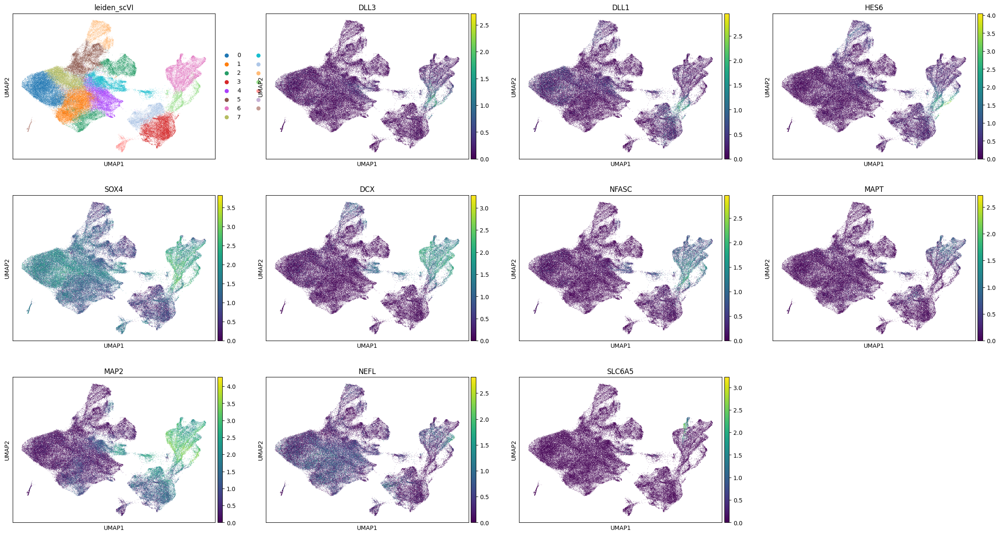

In [126]:
sc.pl.umap(adata, color=[SCVI_CLUSTERS_KEY, "DLL3",'DLL1','HES6','SOX4', 'DCX',
                         'NFASC','MAPT','MAP2', 'NEFL','SLC6A5'])

/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


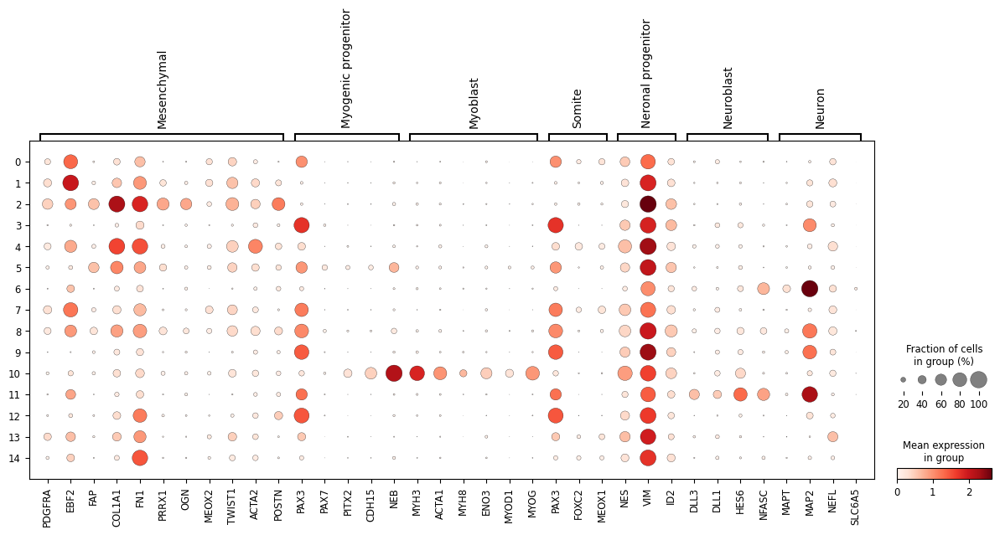

In [127]:
marker_genes = {
    "Mesenchymal": ["PDGFRA",'EBF2','FAP','COL1A1','FN1','PRRX1','OGN','MEOX2','TWIST1','ACTA2','POSTN'],
    "Myogenic progenitor": ['PAX3','PAX7','PITX2','CDH15','NEB'],
    "Myoblast": ['MYH3','ACTA1','MYH8','ENO3','MYOD1','MYOG'],
    "Somite": ['PAX3','FOXC2','MEOX1'],
    "Neronal progenitor": ['NES','VIM','ID2'],
    "Neuroblast": ['DLL3','DLL1', 'HES6', 'NFASC'],
    'Neuron': ['MAPT','MAP2','NEFL', 'SLC6A5']
}
sc.pl.dotplot(adata, marker_genes, groupby=SCVI_CLUSTERS_KEY)

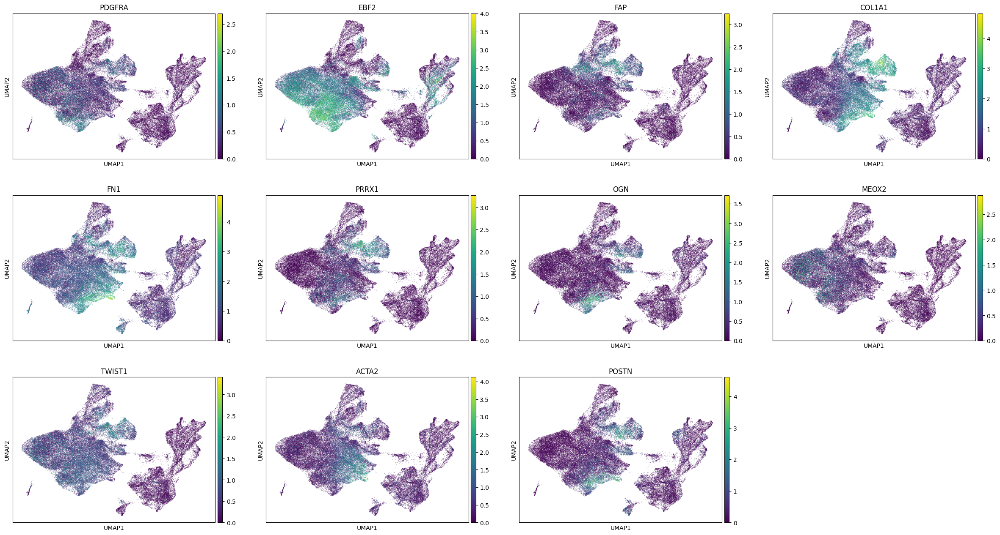

In [93]:
sc.pl.umap(adata, color=marker_genes['Mesenchymal'])

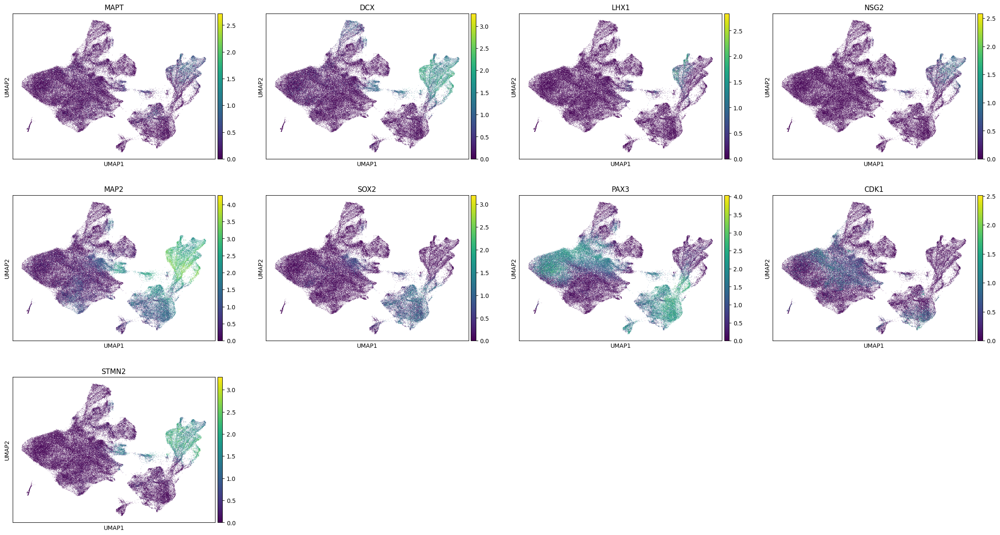

In [74]:
sc.pl.umap(adata, color=marker_genes['Neural'])

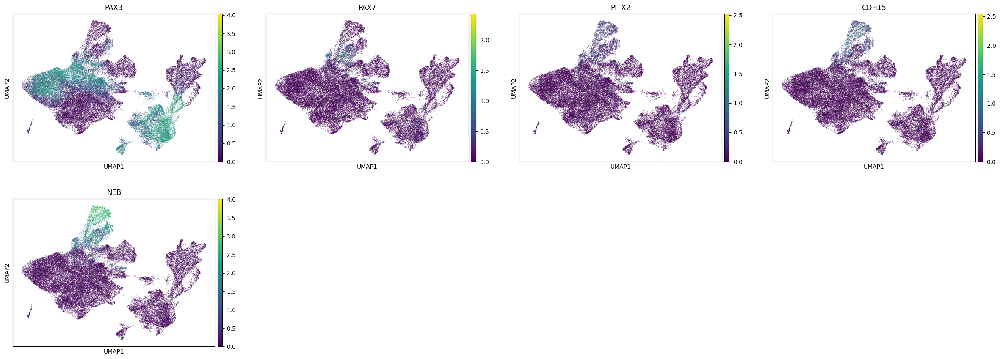

In [75]:
sc.pl.umap(adata, color=marker_genes['Myogenic progenitor'])

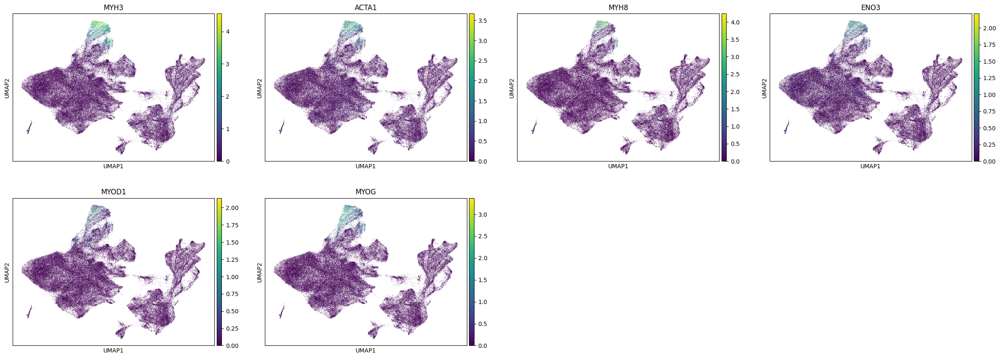

In [77]:
sc.pl.umap(adata, color=marker_genes['Myoblast'])

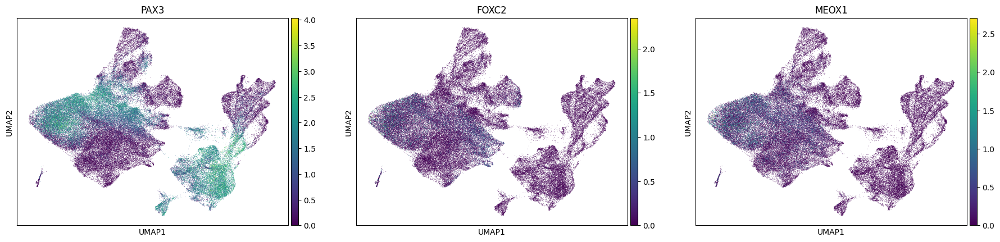

In [109]:
sc.pl.umap(adata, color=marker_genes['Somite'])

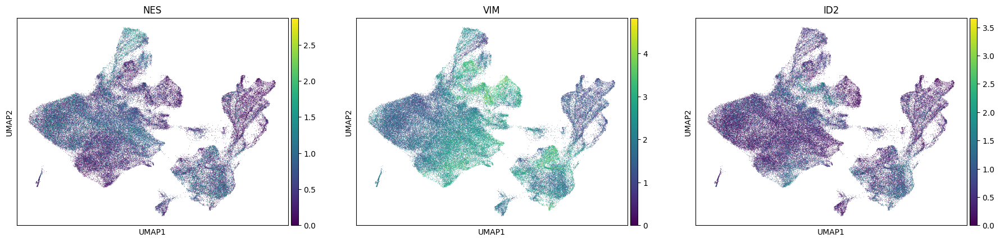

In [128]:
sc.pl.umap(adata, color=marker_genes['Neronal progenitor'])

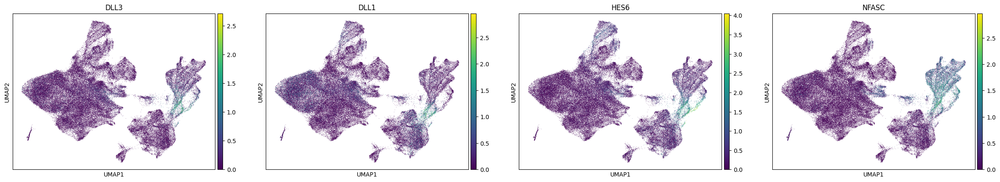

In [129]:
sc.pl.umap(adata, color=marker_genes['Neuroblast'])

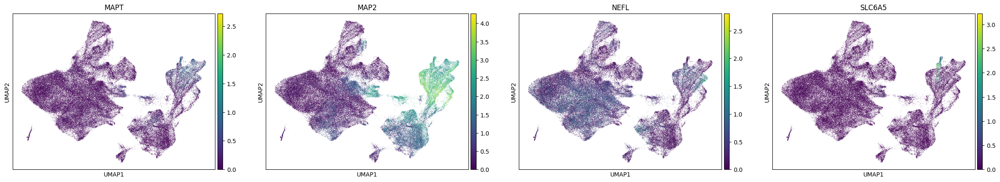

In [130]:
sc.pl.umap(adata, color=marker_genes['Neuron'])

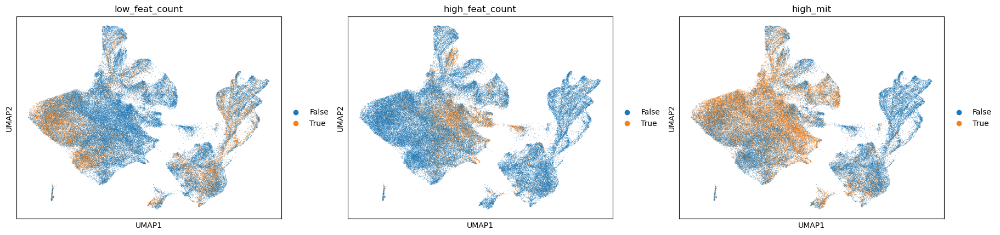

In [30]:
#Where are the low/high feature counts
adata.obs["low_feat_count"] = pd.Categorical(adata.obs.n_genes < 2000)
adata.obs["high_feat_count"] = pd.Categorical(adata.obs.n_genes > 4000)

#Where are the high mitochondrial percentage
adata.obs["high_mit"] = pd.Categorical(adata.obs.pct_counts_mt > 10)

sc.pl.umap(adata, color=['low_feat_count',  'high_feat_count', 'high_mit'])

In [14]:
adata.obs['cell_type'] = adata.obs[SCVI_CLUSTERS_KEY]

#Merge clusters
adata.obs['cell_type'][adata.obs['cell_type']=='7']='0'
adata.obs['cell_type'][adata.obs['cell_type']=='4']='0'
adata.obs['cell_type'][adata.obs['cell_type']=='13']='0'

adata.obs['cell_type'][adata.obs['cell_type']=='1']='2'

adata.obs['cell_type'][adata.obs['cell_type']=='9']='3'
adata.obs['cell_type'][adata.obs['cell_type']=='8']='3'


adata.obs['cell_type'] = adata.obs['cell_type'].cat.set_categories(np.unique(adata.obs['cell_type']).astype('str'))

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_90105/2201196942.py:4: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata.obs['cell_type'][adata.obs['cell_type']=='7']='0'
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykerne

In [18]:
cell_type = pd.read_csv('../../results/cell_types.csv', index_col=0)
adata.obs['cell_type'] = cell_type

adata.obs['cell_type']

AAACAGCCAAACGCGA-1-0                 Somite
AAACAGCCACAGGAAT-1-0                 Somite
AAACAGCCACATGCTA-1-0                 Somite
AAACAGCCAGGCCATT-1-0                 Somite
AAACAGCCATCCGTAA-1-0                 Somite
                               ...         
TTTGTGTTCCCGTTGT-1-7        Immature neuron
TTTGTGTTCGTAATCA-1-7            Mesenchymal
TTTGTTGGTCCGCTGT-1-7            Mesenchymal
TTTGTTGGTGTGAGAG-1-7                 Somite
TTTGTTGGTTTGGTTC-1-7    Neuronal progenitor
Name: cell_type, Length: 100742, dtype: object

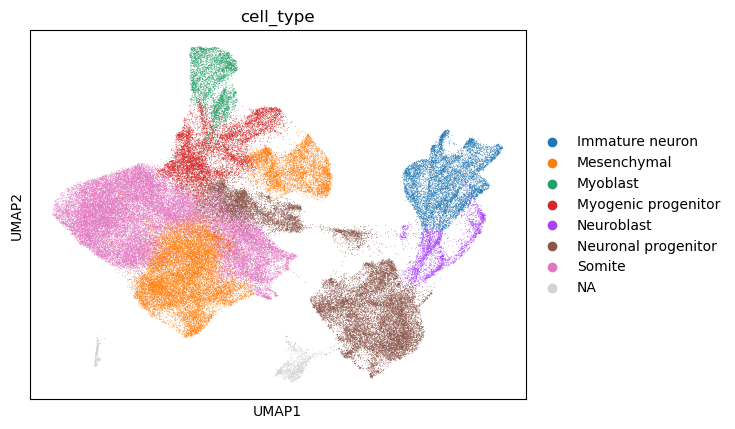

In [19]:
sc.pl.umap(adata, color='cell_type')

/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


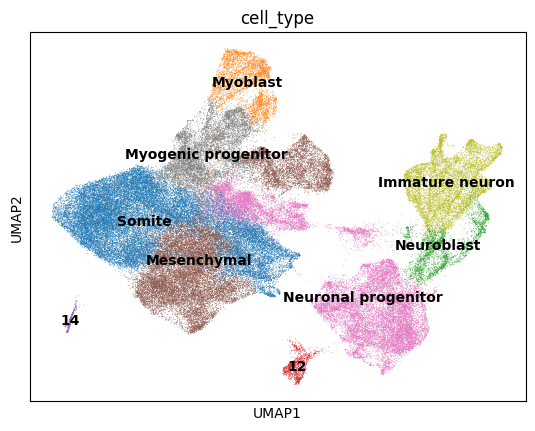

In [20]:
new_cluster_names = [
    "Somite",
    "Myoblast",
    "Neuroblast",
    '12',
    '14',
    'Mesenchymal', 
    'Neuronal progenitor',
    'Myogenic progenitor',
    'Immature neuron'

]
adata.rename_categories("cell_type", new_cluster_names)

sc.pl.umap(adata, color='cell_type', legend_loc="on data")

In [22]:
adata.obs.cell_type

AAACAGCCAAACGCGA-1-0                 Somite
AAACAGCCACAGGAAT-1-0                 Somite
AAACAGCCACATGCTA-1-0                 Somite
AAACAGCCAGGCCATT-1-0                 Somite
AAACAGCCATCCGTAA-1-0                 Somite
                               ...         
TTTGTGTTCCCGTTGT-1-7        Immature neuron
TTTGTGTTCGTAATCA-1-7            Mesenchymal
TTTGTTGGTCCGCTGT-1-7            Mesenchymal
TTTGTTGGTGTGAGAG-1-7                 Somite
TTTGTTGGTTTGGTTC-1-7    Neuronal progenitor
Name: cell_type, Length: 100742, dtype: category
Categories (9, object): ['Somite', 'Myoblast', 'Neuroblast', '12', ..., 'Mesenchymal', 'Neuronal progenitor', 'Myogenic progenitor', 'Immature neuron']

In [27]:
cell_type = adata.obs.cell_type
cell_type = cell_type[cell_type != '12']
cell_type = cell_type[cell_type != '14']
print(cell_type)
cell_type.to_csv('../../results/cell_types.csv')

AAACAGCCAAACGCGA-1-0                 Somite
AAACAGCCACAGGAAT-1-0                 Somite
AAACAGCCACATGCTA-1-0                 Somite
AAACAGCCAGGCCATT-1-0                 Somite
AAACAGCCATCCGTAA-1-0                 Somite
                               ...         
TTTGTGTTCCCGTTGT-1-7        Immature neuron
TTTGTGTTCGTAATCA-1-7            Mesenchymal
TTTGTTGGTCCGCTGT-1-7            Mesenchymal
TTTGTTGGTGTGAGAG-1-7                 Somite
TTTGTTGGTTTGGTTC-1-7    Neuronal progenitor
Name: cell_type, Length: 99275, dtype: category
Categories (9, object): ['Somite', 'Myoblast', 'Neuroblast', '12', ..., 'Mesenchymal', 'Neuronal progenitor', 'Myogenic progenitor', 'Immature neuron']


In [28]:
np.unique(cell_type)

array(['Immature neuron', 'Mesenchymal', 'Myoblast',
       'Myogenic progenitor', 'Neuroblast', 'Neuronal progenitor',
       'Somite'], dtype=object)

# Look at how many cell type we have in each time point

In [55]:
cell_type = pd.read_csv('../../results/cell_types.csv', index_col=0)
cell_type["batch"] =  [int(c[-1]) for c in cell_type.index]
cell_type["batch"] =  [b if b % 2 ==0 else b-1 for b in cell_type.batch]

cell_type

,cell_type,batch
AAACAGCCAAACGCGA-1-0,Somite,0
AAACAGCCACAGGAAT-1-0,Somite,0
AAACAGCCACATGCTA-1-0,Somite,0
AAACAGCCAGGCCATT-1-0,Somite,0
AAACAGCCATCCGTAA-1-0,Somite,0
...,...,...
TTTGTGTTCCCGTTGT-1-7,Immature neuron,6
TTTGTGTTCGTAATCA-1-7,Mesenchymal,6
TTTGTTGGTCCGCTGT-1-7,Mesenchymal,6
TTTGTTGGTGTGAGAG-1-7,Somite,6


In [56]:
cell_type = cell_type.groupby(['batch', 'cell_type']).size()
print(cell_type)
print("Total # cells: ", cell_type.sum())

batch  cell_type          
0      Mesenchymal             1413
       Myogenic progenitor      416
       Neuroblast                 1
       Neuronal progenitor      646
       Somite                 26886
2      Immature neuron          485
       Mesenchymal            10531
       Myoblast                1628
       Myogenic progenitor     3474
       Neuroblast               717
       Neuronal progenitor     9444
       Somite                  4402
4      Immature neuron         3891
       Mesenchymal             6890
       Myoblast                1061
       Myogenic progenitor     2531
       Neuroblast              1596
       Neuronal progenitor     5190
       Somite                   969
6      Immature neuron         3908
       Mesenchymal             2989
       Myoblast                1347
       Myogenic progenitor     2183
       Neuroblast               689
       Neuronal progenitor     5640
       Somite                   348
dtype: int64
Total # cells:  99275


# Look at doublet score

In [26]:
batch_keys_dict = {"0":"D8_REP1", "1":"D8_REP2", "2":"D12_REP1", "3":"D12_REP2", "4":"D20_REP1", "5":"D20_REP2", "6":"D22-15_REP1", "7":"D22-15_REP2"}
batch_keys_dict = {v: k for k, v in batch_keys_dict.items()}

def change_barcodes_name(barcode_id):
    batch_key = barcode_id[:-5].split("-", 1)
    barcode =  batch_key[0]; batch_key = batch_key[1]

    batch_key = batch_keys_dict[batch_key[2:]]

    return barcode + "-1-" + batch_key

doublet_score = pd.read_csv("../../data/doublet_scores.csv", index_col="Unnamed: 0")
doublet_score.index = doublet_score.index.map(change_barcodes_name)

In [44]:
doublet_score

,scDblFinder.score_RNA,scDblFinder.class_RNA,scDblFinder.score_ATAC,scDblFinder.class_ATAC
AAACAGCCAAACGCGA-1-0,0.085178,singlet,0.071363,singlet
AAACAGCCAATGCCTA-1-0,0.002101,singlet,0.213061,singlet
AAACAGCCACAGGAAT-1-0,0.012566,singlet,0.031406,singlet
AAACAGCCACATGCTA-1-0,0.005161,singlet,0.112643,singlet
AAACAGCCAGGCCATT-1-0,0.015622,singlet,0.143660,singlet
...,...,...,...,...
TTTGTGTTCCCGTTGT-1-7,0.017799,singlet,0.999534,doublet
TTTGTGTTCGTAATCA-1-7,0.001264,singlet,0.020066,singlet
TTTGTTGGTCCGCTGT-1-7,0.023045,singlet,0.094221,singlet
TTTGTTGGTGTGAGAG-1-7,0.001091,singlet,0.006007,singlet


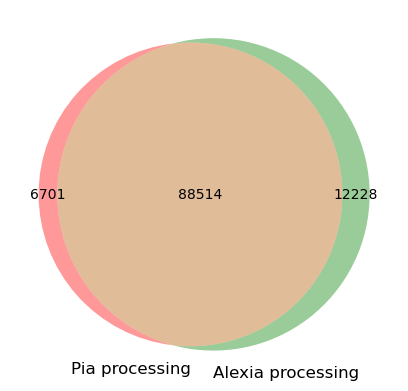

In [37]:
import matplotlib.pyplot as plt
from matplotlib_venn import venn2

set1 = set(doublet_score.index)
set2 = set(adata.obs_names)

venn2([set1, set2], ('Pia processing', 'Alexia processing'))

plt.show()

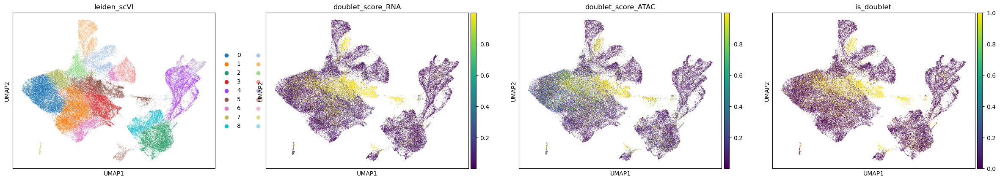

In [46]:
#Where are the doublet computed by Pia
common_cells = doublet_score.index.intersection(adata.obs_names)
adata.obs["doublet_score_RNA"] = doublet_score.loc[common_cells].iloc[:,0]
adata.obs["doublet_score_ATAC"] = doublet_score.loc[common_cells].iloc[:,2]
adata.obs["is_doublet"] = np.logical_or(doublet_score.loc[common_cells].iloc[:,1] == "doublet", doublet_score.loc[common_cells].iloc[:,3] == "doublet")


sc.pl.umap(adata, color=[SCVI_CLUSTERS_KEY,  'doublet_score_RNA', 'doublet_score_ATAC', 'is_doublet'])

# Retrain embedding with Pia's filtering

In [54]:
batch_keys_dict = {"0":"D8_REP1", "1":"D8_REP2", "2":"D12_REP1", "3":"D12_REP2", "4":"D20_REP1", "5":"D20_REP2", "6":"D22-15_REP1", "7":"D22-15_REP2"}
batch_keys_dict = {v: k for k, v in batch_keys_dict.items()}

def change_barcodes_name(barcode_id):
    batch_key = barcode_id[:-5].split("-", 1)
    barcode =  batch_key[0]; batch_key = batch_key[1]

    batch_key = batch_keys_dict[batch_key[2:]]

    return barcode + "-1-" + batch_key

doublet_score = pd.read_csv("../../data/doublet_scores.csv", index_col="Unnamed: 0")
doublet_score.index = doublet_score.index.map(change_barcodes_name)

In [63]:
from tqdm import tqdm

cells_keep = doublet_score.index[~np.logical_or(doublet_score.iloc[:,1] == "doublet", doublet_score.iloc[:,3] == "doublet")]

dir_name = ['D8_1','D8_2','D12_1','D12_2','D20_1', 'D20_2', 'D22_1', 'D22_2']

adatasets = []
for i,name in enumerate(tqdm(dir_name)):

    exec(f"adata_tmp = sc.read_10x_mtx('../../data/initial_10x_outputs/filtered_features/filtered_feature_bc_matrix-' + name)")
    
    #Filter cells using Pia's filtering
    cells_batch = [c.endswith(str(i)) for c in cells_keep]
    cells_batch = cells_keep[cells_batch]
    cells_batch =  [c[:-2] for c in cells_batch]
    cells_batch = adata_tmp.obs_names.intersection(cells_batch)
    adata_tmp = adata_tmp[cells_batch,:]

    # log nomalize to median total counts
    sc.pp.normalize_total(adata_tmp)
    sc.pp.log1p(adata_tmp)
        
    adatasets.append(adata_tmp)        

  0%|          | 0/8 [00:00<?, ?it/s]

/Applications/anaconda3/envs/scvi/lib/python3.10/site-packages/scanpy/preprocessing/_normalization.py:206: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
 12%|█▎        | 1/8 [01:05<07:39, 65.58s/it]/Applications/anaconda3/envs/scvi/lib/python3.10/site-packages/scanpy/preprocessing/_normalization.py:206: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
 25%|██▌       | 2/8 [02:25<07:24, 74.04s/it]/Applications/anaconda3/envs/scvi/lib/python3.10/site-packages/scanpy/preprocessing/_normalization.py:206: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
 38%|███▊      | 3/8 [03:39<06:10, 74.10s/it]/Applications/anaconda3/envs/scvi/lib/python3.10/site-packages/scanpy/preprocessing/_normalization.py:206: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
 50%|█████     | 4/8 [04:43<04:39, 69.92s/it]/Applications/anaconda3/envs/scvi/lib/python3.10/site-packag

In [64]:
adata = adatasets[0]
adata = adata.concatenate(adatasets[1:], join="outer")

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_20862/2920346992.py:2: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  adata = adata.concatenate(adatasets[1:], join="outer")


In [65]:
# change batch keys to be replicate id
batch_keys_dict = {"0":"D8-1", "1":"D8-2", "2":"D12-1", "3":"D12-2", "4":"D20-1", "5":"D20-2", "6":"D22-1", "7":"D22-2"}
adata.obs['batch'] = adata.obs.batch.cat.rename_categories(batch_keys_dict)
adata.obs.batch

AAACAGCCAAACGCGA-1-0     D8-1
AAACAGCCAATGCCTA-1-0     D8-1
AAACAGCCACAGGAAT-1-0     D8-1
AAACAGCCACATGCTA-1-0     D8-1
AAACAGCCAGGCCATT-1-0     D8-1
                        ...  
TTTGTGGCACATTGCA-1-7    D22-2
TTTGTGTTCGTAATCA-1-7    D22-2
TTTGTTGGTCCGCTGT-1-7    D22-2
TTTGTTGGTGTGAGAG-1-7    D22-2
TTTGTTGGTTTGGTTC-1-7    D22-2
Name: batch, Length: 71315, dtype: category
Categories (8, object): ['D8-1', 'D8-2', 'D12-1', 'D12-2', 'D20-1', 'D20-2', 'D22-1', 'D22-2']

In [66]:
#Feature selection 
sc.pp.highly_variable_genes(adata, 
                            n_top_genes=5000,
                            flavor='seurat_v3',
                            batch_key='batch'
)

adata = adata[:, adata.var.highly_variable].copy()
adata

/Applications/anaconda3/envs/scvi/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:72: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(


AnnData object with n_obs × n_vars = 71315 × 5000
    obs: 'batch'
    var: 'gene_ids', 'feature_types', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'hvg'

In [68]:
# Set up the model for scvi
adata.layers["counts"] = adata.X.copy()  
scvi.model.SCVI.setup_anndata(
    adata,
    layer="counts",
    batch_key='batch'
)

sc.pp.highly_variable_genes(adata, 
                            n_top_genes=5000,
                            flavor='seurat_v3',
                            batch_key='batch'
)

model = scvi.model.SCVI(adata)
model

/Applications/anaconda3/envs/scvi/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.layers[counts] does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)
/Applications/anaconda3/envs/scvi/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:72: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(


SCVI model with the following parameters: 
n_hidden: 128, n_latent: 10, n_layers: 1, dropout_rate: 0.1, dispersion: gene, gene_likelihood: zinb, 
latent_distribution: normal.
Training status: Not Trained
Model's adata is minified?: False

In [ ]:
model.train()

In [70]:
model_dir =  "../data/models/new_filtering_scvi_model"
model.save(model_dir, overwrite=True)

INFO     File ../data/models/new_filtering_scvi_model/model.pt already downloaded                                  


/Applications/anaconda3/envs/scvi/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.layers[counts] does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


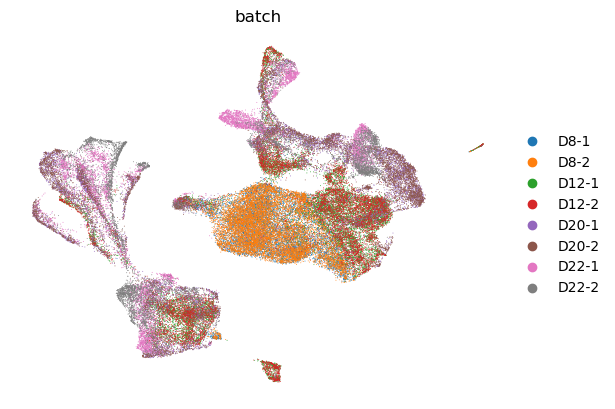

In [72]:
model_dir =  "../data/models/new_filtering_scvi_model"
model = scvi.model.SCVI.load(model_dir, adata=adata)

SCVI_LATENT_KEY = "X_scVI"

latent = model.get_latent_representation()
adata.obsm[SCVI_LATENT_KEY] = latent
latent.shape

# use scVI latent space for UMAP generation
sc.pp.neighbors(adata, use_rep=SCVI_LATENT_KEY)

sc.tl.umap(adata, min_dist=0.3)

sc.pl.umap(
    adata,
    color=["batch"],
    frameon=False
)

In [80]:
cell_type.loc[adata.obs_names.intersection(cell_type.index),:]

,cell_type
AAACAGCCAAACGCGA-1-0,Somite
AAACAGCCACAGGAAT-1-0,Somite
AAACAGCCACATGCTA-1-0,Somite
AAACAGCCAGGCCATT-1-0,Somite
AAACAGCCATCCGTAA-1-0,Somite
...,...
TTTGTGGCACATTGCA-1-7,Neuronal progenitor
TTTGTGTTCGTAATCA-1-7,Mesenchymal
TTTGTTGGTCCGCTGT-1-7,Mesenchymal
TTTGTTGGTGTGAGAG-1-7,Somite


/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_20862/2384640908.py:4: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["cell_type"]= cell_type.loc[adata.obs_names,:]


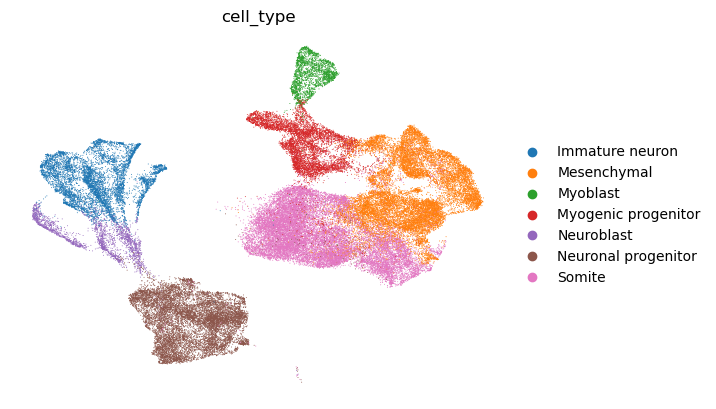

In [81]:
cell_type = pd.read_csv('../../results/cell_types.csv', index_col=0)
defined_cells = adata.obs_names.intersection(cell_type.index)
adata = adata[defined_cells,:]
adata.obs["cell_type"]= cell_type.loc[adata.obs_names,:]

sc.pl.umap(
    adata,
    color=["cell_type"],
    frameon=False
)

# Differential gene anlysis + GO enrichment per cluster

Following tutorial: https://github.com/mousepixels/sanbomics_scripts/blob/main/GO_in_python.ipynb

## Setup GO analysis

In [25]:
!pip install goatools

/Applications/anaconda3/envs/scvi/lib/python3.10/pty.py:89: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid, fd = os.forkpty()


  Using cached docopt-0.6.2.tar.gz (25 kB)
  Preparing metadata (setup.py) ... done
  Using cached XlsxWriter-3.2.0-py3-none-any.whl.metadata (2.6 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.8/15.8 MB 29.4 MB/s eta 0:00:0000:0100:01
Using cached XlsxWriter-3.2.0-py3-none-any.whl (159 kB)
  Created wheel for docopt: filename=docopt-0.6.2-py2.py3-none-any.whl size=13706 sha256=db7936944185b7a0104ffa4c63234f1e97e493ded4feab8fab8609f6b02ed77d
  Stored in directory: /Users/adorman/Library/Caches/pip/wheels/fc/ab/d4/5da2067ac95b36618c629a5f93f809425700506f72c9732fac
Successfully built docopt


In [31]:
!pwd
!python ~/../../Applications/anaconda3/envs/scvi/bin/ncbi_gene_results_to_python.py -o genes_ncbi_proteincoding.py gene_result.txt

/Users/adorman/Documents/master-thesis/src/exploration
      20,630 lines READ:  gene_result.txt
      20,609 geneids WROTE: genes_ncbi_proteincoding.py


In [36]:
from genes_ncbi_proteincoding import GENEID2NT as GeneID2nt_mus
from goatools.base import download_go_basic_obo
from goatools.base import download_ncbi_associations
from goatools.obo_parser import GODag
from goatools.anno.genetogo_reader import Gene2GoReader
from goatools.goea.go_enrichment_ns import GOEnrichmentStudyNS

#run one time to initialize
obo_fname = download_go_basic_obo()
fin_gene2go = download_ncbi_associations()
obodag = GODag("go-basic.obo")

mapper = {}

for key in GeneID2nt_mus:
    mapper[GeneID2nt_mus[key].Symbol] = GeneID2nt_mus[key].GeneID
    
inv_map = {v: k for k, v in mapper.items()}

# Read NCBI's gene2go. Store annotations in a list of namedtuples
objanno = Gene2GoReader(fin_gene2go, taxids=[9606])
# Get namespace2association where:
#    namespace is:
#        BP: biological_process               
#        MF: molecular_function
#        CC: cellular_component
#    assocation is a dict:
#        key: NCBI GeneID
#        value: A set of GO IDs associated with that gene
ns2assoc = objanno.get_ns2assc()

goeaobj = GOEnrichmentStudyNS(
        GeneID2nt_mus.keys(), # List of mouse protein-coding genes
        ns2assoc, # geneid/GO associations
        obodag, # Ontologies
        propagate_counts = False,
        alpha = 0.05, # default significance cut-off
        methods = ['fdr_bh']) # defult multipletest correction method

GO_items = []

temp = goeaobj.ns2objgoea['BP'].assoc
for item in temp:
    GO_items += temp[item]
    

temp = goeaobj.ns2objgoea['CC'].assoc
for item in temp:
    GO_items += temp[item]
    

temp = goeaobj.ns2objgoea['MF'].assoc
for item in temp:
    GO_items += temp[item]

#pass list of gene symbols
def go_it(test_genes):
    print(f'input genes: {len(test_genes)}')
    
    mapped_genes = []
    for gene in test_genes:
        try:
            mapped_genes.append(mapper[gene])
        except:
            pass
    print(f'mapped genes: {len(mapped_genes)}')
    
    goea_results_all = goeaobj.run_study(mapped_genes)
    goea_results_sig = [r for r in goea_results_all if r.p_fdr_bh < 0.05]
    GO = pd.DataFrame(list(map(lambda x: [x.GO, x.goterm.name, x.goterm.namespace, x.p_uncorrected, x.p_fdr_bh,\
                   x.ratio_in_study[0], x.ratio_in_study[1], GO_items.count(x.GO), list(map(lambda y: inv_map[y], x.study_items)),\
                   ], goea_results_sig)), columns = ['GO', 'term', 'class', 'p', 'p_corr', 'n_genes',\
                                                    'n_study', 'n_go', 'study_genes'])

    GO = GO[GO.n_genes > 1]
    return GO

$ get http://purl.obolibrary.org/obo/go/go-basic.obo
requests.get(http://purl.obolibrary.org/obo/go/go-basic.obo, stream=True)
  WROTE: go-basic.obo

$ get ftp://ftp.ncbi.nlm.nih.gov/gene/DATA/gene2go.gz
FTP RETR ftp.ncbi.nlm.nih.gov gene/DATA gene2go.gz -> gene2go.gz
$ gunzip gene2go.gz
go-basic.obo: fmt(1.2) rel(2024-06-17) 45,494 Terms
HMS:0:01:41.237864 347,845 annotations, 20,780 genes, 18,718 GOs, 1 taxids READ: gene2go 

Load BP Ontology Enrichment Analysis ...
 83% 17,030 of 20,609 population items found in association

Load CC Ontology Enrichment Analysis ...
 88% 18,166 of 20,609 population items found in association

Load MF Ontology Enrichment Analysis ...
 85% 17,620 of 20,609 population items found in association


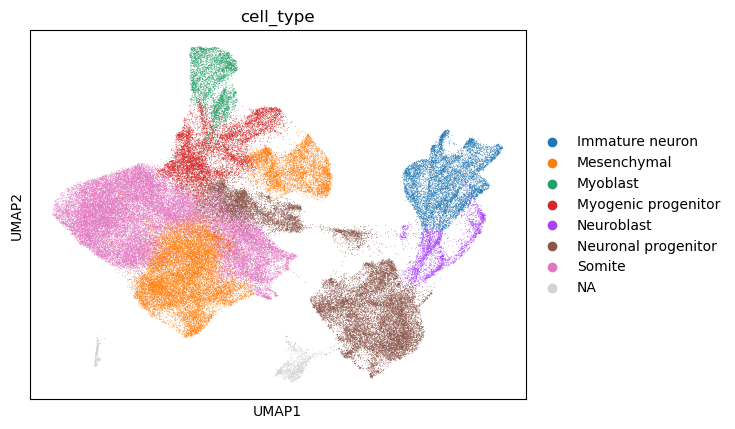

In [20]:
cell_type = pd.read_csv('../../results/cell_types.csv', index_col=0)
adata.obs['cell_type'] = cell_type

sc.pl.umap(adata, color='cell_type')

In [22]:
sc.tl.rank_genes_groups(adata, 'cell_type', method='wilcoxon')
    
#find markers
results = adata.uns['rank_genes_groups']
out = np.array([[0,0,0,0,0]])
for group in results['names'].dtype.names:
    out = np.vstack((out, np.vstack((results['names'][group],
                                        results['scores'][group],
                                        results['pvals_adj'][group],
                                        results['logfoldchanges'][group],
                                        np.array([group] * len(results['names'][group])).astype('object'))).T))

markers = pd.DataFrame(out[1:], columns = ['Gene', 'scores', 'pval_adj', 'lfc', 'cluster'])
adata.uns['markers'] = markers #save marker df to uns


In [23]:
markers

,Gene,scores,pval_adj,lfc,cluster
0,MAP2,140.01474,0.0,4.509284,Immature neuron
1,STMN2,133.75798,0.0,5.526654,Immature neuron
2,DCX,128.873932,0.0,4.825669,Immature neuron
3,KIF5C,126.658234,0.0,3.895316,Immature neuron
4,NRXN1,125.230232,0.0,5.065505,Immature neuron
...,...,...,...,...,...
34995,MAP2,-113.447052,0.0,-3.855764,Somite
34996,NFIA,-117.555832,0.0,-2.626685,Somite
34997,DCLK1,-117.697136,0.0,-3.975339,Somite
34998,ZFHX4,-119.996902,0.0,-2.361322,Somite


input genes: 149
mapped genes: 149

Runing BP Ontology Analysis: current study set of 149 IDs.
 93%    139 of    149 study items found in association
100%    149 of    149 study items found in population(20609)
Calculating 12,143 uncorrected p-values using fisher_scipy_stats
  12,143 terms are associated with 17,030 of 20,609 population items
   1,241 terms are associated with    139 of    149 study items
  METHOD fdr_bh:
       9 GO terms found significant (< 0.05=alpha) (  9 enriched +   0 purified): statsmodels fdr_bh
      38 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Runing CC Ontology Analysis: current study set of 149 IDs.
 97%    145 of    149 study items found in association
100%    149 of    149 study items found in population(20609)
Calculating 1,811 uncorrected p-values using fisher_scipy_stats
   1,811 terms are associated with 18,166 of 20,609 population items
     199 terms are associated 

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_90105/2326461438.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels([textwrap.fill(e, 35) for e in df['term']])


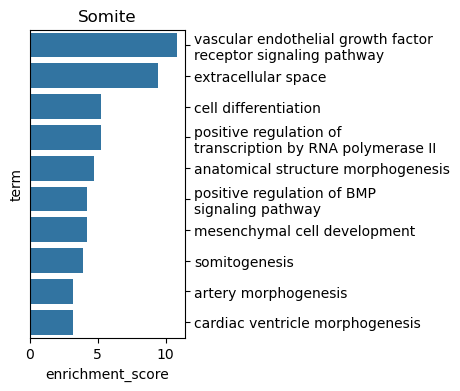

In [77]:
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib import cm
import seaborn as sns
import textwrap

cluster_name = np.unique(markers.cluster)

for c in cluster_name:
    if c == 'Somite':
        #Get differentiated genes of cluster
        ec_markers = adata.uns['markers']
        ec_markers = ec_markers[(ec_markers.cluster == c) & (ec_markers.pval_adj < 0.05) & (ec_markers.lfc > 1.5)]

        #Run GO enrichment
        df = go_it(ec_markers.Gene.values)

        df['enrichment_score'] = -np.log(df.p_corr)
        df = df[0:10]
        df = df.sort_values('enrichment_score', ascending=False)

        #Plot barplot
        plt.figure(figsize = (2,4))
        ax = sns.barplot(data = df, x = 'enrichment_score', y = 'term')
        ax.yaxis.tick_right()
        ax.set_yticklabels([textwrap.fill(e, 35) for e in df['term']])
        ax.set_title(c)
        plt.show()

